<div class="alert alert-block alert-info"><b></b>
<h1><center> <font color='black'> Homework 02  </font></center></h1>
<h2><center> <font color='black'> Customer segmentation and regression problems </font></center></h2>    
<h2><center> <font color='black'> BDA - University of Tartu - Spring 2020</font></center></h3>
</div>

# Homework instructions

- Insert your team member names and student IDs in the field "Team mates" below. If you are not working in a team please insert only your name, surname and student ID 

- The accepted submission formats are Colab links or .ipynb files. If you are submitting Colab links please make sure that the privacy settings for the file is public so we can access your code. 

- The submission will automatically close at 12:00 am, so please make sure you have enough time to submit the homework. 

- Only one of the teammates should submit the homework. We will grade and give points to both of you! 

- You do not necessarily need to work on Colab. Especially as the size and the complexity of datasets will increase through the course, you can install jupyter notebooks locally and work from there.

- If you do not understand what a question is asking for, please ask in Moodle. 


**<h2><font color='red'>Team mates:</font></h2>**


<font color='red'>Name Surname: Enlik -</font>&emsp;   <font color='red'>Student ID: B96323</font>


<font color='red'>Name Surname: XXXXX</font>&emsp;   <font color='red'>Student ID: YYYY</font>




In [79]:
## To resolve notebook json issue related to Plotly
# !pip install nbformat=4.4.0

In [80]:
import numpy as np 
import pandas as pd 
import datetime as dt 

import seaborn as sns
import matplotlib.pyplot as plt
import plotly.offline as pyoff
import plotly.graph_objs as go
from plotly.subplots import make_subplots

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from scipy.stats import norm


## Ignore warning message
import warnings

warnings.simplefilter('ignore')

# 1. RFM technique (3 points)

In this homework we will apply the RFM technique similarly to what we did in the practice session. The dataset we are using belongs to http://donorschoose.org/. 

The web platform http://donorschoose.org helps projects in collecting donations. The donators do have the option to give 15% of what they donate to this webplatform. The dataset contains the following fields:

- Donor ID - Unique identifier of donors
- Donation Included Optional Donation - The donor has agreed(Yes/No) to give 15% of donation amount to Donoschoose.org
- Donation Amount - Total amount donated
- Donor Cart Sequence - The ranking of the donaton project in the donors list
- Donation Received Date - Date of online payment


**1.0.**
**Please load the dataset Donations.csv. The field "Donation Included Optional Donation" shows if the donor has agreed (Yes/No) to give 15% of donation amount to Donoschoose.org. Update the field "Donation Amount" as such that it will show the correct amount the donor has given for the charity projects in case where the answer is Yes to "Donation Included Optional Donation". (0.30 points)** 

In [81]:
donations = pd.read_csv("Donations.csv", sep = " ")

In [82]:
donations.head()

,Donor ID,Donation Included Optional Donation,Donation Amount,Donor Cart Sequence,Donation Received Date
0,1f4b5b6e68445c6c4a0509b3aca93f38,No,178.37,11,2016-08-23 13:15:57
1,bd323208dc78b1c74b62664b768f3176,Yes,200.00,2,2013-02-17 21:36:24
2,6dd6113f89f2766d3b0707ef2a46260c,Yes,10.00,44,2013-02-27 10:32:22
3,344ad0a72366a27bd4926bbe5d066939,Yes,10.00,9,2017-07-24 08:40:35
4,3cf2607d4131cd654bf54a1f5a533357,Yes,25.00,5,2017-07-11 16:40:30


In [83]:
# OLD LOGIC

# def updateDonationAmount(isIncluded, amount):
#     if isIncluded == "Yes":
#         return amount - (0.15 * amount)
#     else:
#         return amount

# donations['Donation Amount'] = donations.apply(
#     lambda x: updateDonationAmount(x['Donation Included Optional Donation'], x['Donation Amount']), axis=1)

In [84]:
# NEW LOGIC

donations.loc[
    donations['Donation Included Optional Donation'] == 
    'Yes', 'Donation Amount'] = donations['Donation Amount'] - (0.15 * donations['Donation Amount'])

In [85]:
donations.head()

,Donor ID,Donation Included Optional Donation,Donation Amount,Donor Cart Sequence,Donation Received Date
0,1f4b5b6e68445c6c4a0509b3aca93f38,No,178.37,11,2016-08-23 13:15:57
1,bd323208dc78b1c74b62664b768f3176,Yes,170.00,2,2013-02-17 21:36:24
2,6dd6113f89f2766d3b0707ef2a46260c,Yes,8.50,44,2013-02-27 10:32:22
3,344ad0a72366a27bd4926bbe5d066939,Yes,8.50,9,2017-07-24 08:40:35
4,3cf2607d4131cd654bf54a1f5a533357,Yes,21.25,5,2017-07-11 16:40:30


**1.1. For `Recency`, consider 2018-05-31 23:00:00 as the reference date
(we assume this is report date). Calculate the number of days between this date and the date of last purchase  for each customer. How long the donor with ID equal to e0fe4d9b8def8a71635e65ba4ff5ef40 has been inactive ? (0.30 points)** 


In [86]:
# Reference
# https://stackoverflow.com/questions/50089903/convert-column-to-timestamp-pandas-dataframe

# Convert column 'Donation Received Date' into date type (timestamp)
donations['Donation Received Date'] = pd.to_datetime(donations['Donation Received Date'], format = "%Y-%m-%d %H:%M:%S")

In [87]:
# Create a generic user dataframe to keep Donor ID and new segmentation scores (RFM)
donations_user = pd.DataFrame(donations['Donor ID'].unique())
donations_user.columns = ['Donor ID']
print(donations_user)


                                Donor ID
0       1f4b5b6e68445c6c4a0509b3aca93f38
1       bd323208dc78b1c74b62664b768f3176
2       6dd6113f89f2766d3b0707ef2a46260c
3       344ad0a72366a27bd4926bbe5d066939
4       3cf2607d4131cd654bf54a1f5a533357
...                                  ...
129060  7c3a054108a9eebb441054450d76a9d3
129061  da71310482043b4da3e1bb1ab80850e8
129062  d1e1e4fc0975a7936940a3708f1860c9
129063  ead077ee750c0a4d2190afdb202a6343
129064  56729cfddae7e622f7d49ba5877c4e5c

[129065 rows x 1 columns]


In [88]:
# Get the last purchase date for each donors and create a dataframe from it 
lastPurchaseDate = donations.groupby('Donor ID')['Donation Received Date'].max().reset_index()
lastPurchaseDate.columns = ['Donor ID', 'LastPurchaseDate']
print(lastPurchaseDate)

                                Donor ID    LastPurchaseDate
0       00002d44003ed46b066607c5455a999a 2017-10-18 14:34:11
1       00002eb25d60a09c318efbd0797bffb5 2018-01-16 15:32:41
2       00006084c3d92d904a22e0a70f5c119a 2018-04-14 23:04:42
3       0001107b9faa5c3bb42cfcecece1d587 2018-03-24 19:43:59
4       0001f63e9437ebbba6ddaae0664037a7 2017-03-09 07:10:03
...                                  ...                 ...
129060  fffc8063fefd271719cb27cd019de746 2016-09-01 22:40:57
129061  fffcffed2771863a61c9669049cc6876 2013-11-25 23:49:34
129062  fffd67203dc580485e30d8a8820ef2bf 2018-04-25 18:50:51
129063  fffd69c0f1dc11f7fc10d595891723a2 2018-03-15 00:38:54
129064  fffe56ecd1382490b5995a308d9476d9 2015-08-05 17:25:37

[129065 rows x 2 columns]


In [89]:
# create variable reportDate based on mentioned reference date above
reportDate = dt.datetime.strptime('2018-05-31 23:00:00', '%Y-%m-%d %H:%M:%S')

lastPurchaseDate['Recency'] = (reportDate - lastPurchaseDate['LastPurchaseDate']).dt.days
print(lastPurchaseDate)

                                Donor ID    LastPurchaseDate  Recency
0       00002d44003ed46b066607c5455a999a 2017-10-18 14:34:11      225
1       00002eb25d60a09c318efbd0797bffb5 2018-01-16 15:32:41      135
2       00006084c3d92d904a22e0a70f5c119a 2018-04-14 23:04:42       46
3       0001107b9faa5c3bb42cfcecece1d587 2018-03-24 19:43:59       68
4       0001f63e9437ebbba6ddaae0664037a7 2017-03-09 07:10:03      448
...                                  ...                 ...      ...
129060  fffc8063fefd271719cb27cd019de746 2016-09-01 22:40:57      637
129061  fffcffed2771863a61c9669049cc6876 2013-11-25 23:49:34     1647
129062  fffd67203dc580485e30d8a8820ef2bf 2018-04-25 18:50:51       36
129063  fffd69c0f1dc11f7fc10d595891723a2 2018-03-15 00:38:54       77
129064  fffe56ecd1382490b5995a308d9476d9 2015-08-05 17:25:37     1030

[129065 rows x 3 columns]


In [90]:
# Merge into main dataframe
donations_user = pd.merge(donations_user, lastPurchaseDate[['Donor ID','Recency']], on='Donor ID')
print(donations_user)

                                Donor ID  Recency
0       1f4b5b6e68445c6c4a0509b3aca93f38      126
1       bd323208dc78b1c74b62664b768f3176     1012
2       6dd6113f89f2766d3b0707ef2a46260c     1025
3       344ad0a72366a27bd4926bbe5d066939      242
4       3cf2607d4131cd654bf54a1f5a533357      133
...                                  ...      ...
129060  7c3a054108a9eebb441054450d76a9d3       93
129061  da71310482043b4da3e1bb1ab80850e8     1871
129062  d1e1e4fc0975a7936940a3708f1860c9      498
129063  ead077ee750c0a4d2190afdb202a6343      289
129064  56729cfddae7e622f7d49ba5877c4e5c     1668

[129065 rows x 2 columns]


In [91]:
# plot a recency histogram distribution of recency across our donors.
# reference: BDA2020 - lab03 practice material
# https://drive.google.com/file/d/1bTAKH9MOyf3Wg5qZ3nrjNAqD_plwGt4H/view

plot_data = [
    go.Histogram(
        x=donations_user['Recency']
    )
]

plot_layout = go.Layout(
        title='Distribution of recency across our Donor.'
    )

fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [92]:
donations_user[donations_user['Donor ID'] == "e0fe4d9b8def8a71635e65ba4ff5ef40"]

,Donor ID,Recency
67193,e0fe4d9b8def8a71635e65ba4ff5ef40,34


**<font color='red'>Answer:</font>** 34 days

**1.2. For the "Frequency" calculate how many times  a user has donated. What is the frequency value for the donor with ID e0fe4d9b8def8a71635e65ba4ff5ef40? (0.30 points)**

In [93]:
# create a dataframe with frequency column based on total count of Donation for every donor ID
donations_frequency = donations.groupby('Donor ID')['Donation Received Date'].count().reset_index()
donations_frequency.columns = ['Donor ID', 'Frequency']
donations_frequency

,Donor ID,Frequency
0,00002d44003ed46b066607c5455a999a,11
1,00002eb25d60a09c318efbd0797bffb5,5
2,00006084c3d92d904a22e0a70f5c119a,18
3,0001107b9faa5c3bb42cfcecece1d587,47
4,0001f63e9437ebbba6ddaae0664037a7,7
...,...,...
129060,fffc8063fefd271719cb27cd019de746,5
129061,fffcffed2771863a61c9669049cc6876,5
129062,fffd67203dc580485e30d8a8820ef2bf,5
129063,fffd69c0f1dc11f7fc10d595891723a2,14


In [94]:
# merge the new dataframe into our new user dataframe
donations_user = pd.merge(donations_user, donations_frequency, on="Donor ID")
donations_user

,Donor ID,Recency,Frequency
0,1f4b5b6e68445c6c4a0509b3aca93f38,126,314
1,bd323208dc78b1c74b62664b768f3176,1012,5
2,6dd6113f89f2766d3b0707ef2a46260c,1025,27
3,344ad0a72366a27bd4926bbe5d066939,242,9
4,3cf2607d4131cd654bf54a1f5a533357,133,8
...,...,...,...
129060,7c3a054108a9eebb441054450d76a9d3,93,6
129061,da71310482043b4da3e1bb1ab80850e8,1871,5
129062,d1e1e4fc0975a7936940a3708f1860c9,498,6
129063,ead077ee750c0a4d2190afdb202a6343,289,10


In [95]:
donations_user['Frequency'].describe()

count    129065.000000
mean         16.810398
std         112.850319
min           5.000000
25%           6.000000
50%           8.000000
75%          12.000000
max       18035.000000
Name: Frequency, dtype: float64

In [96]:
# plot a frequency histogram distribution of recency across our donors.
plot_data = [
    go.Histogram(
        x=donations_user.query('Frequency < 100')['Frequency']
    )
]

plot_layout = go.Layout(
        title='Distribution of Frequency across our Donors.'
    )

fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [97]:
donations_frequency[donations_frequency['Donor ID'] == 'e0fe4d9b8def8a71635e65ba4ff5ef40']

,Donor ID,Frequency
113469,e0fe4d9b8def8a71635e65ba4ff5ef40,9


**<font color='red'>Answer:</font>** 9 

**1.3. For the "Revenue" calculate how much a donor has donated. What is the revenue value for the donor with ID e0fe4d9b8def8a71635e65ba4ff5ef40? (0.30 points)**

In [98]:
donations.head()

,Donor ID,Donation Included Optional Donation,Donation Amount,Donor Cart Sequence,Donation Received Date
0,1f4b5b6e68445c6c4a0509b3aca93f38,No,178.37,11,2016-08-23 13:15:57
1,bd323208dc78b1c74b62664b768f3176,Yes,170.00,2,2013-02-17 21:36:24
2,6dd6113f89f2766d3b0707ef2a46260c,Yes,8.50,44,2013-02-27 10:32:22
3,344ad0a72366a27bd4926bbe5d066939,Yes,8.50,9,2017-07-24 08:40:35
4,3cf2607d4131cd654bf54a1f5a533357,Yes,21.25,5,2017-07-11 16:40:30


In [99]:
# Calculate revenue for each donors based on their total donation amount
donations_revenue = donations.groupby('Donor ID')['Donation Amount'].sum().reset_index()
donations_revenue.columns = ['Donor ID', 'Revenue']
donations_revenue

,Donor ID,Revenue
0,00002d44003ed46b066607c5455a999a,597.6075
1,00002eb25d60a09c318efbd0797bffb5,178.5000
2,00006084c3d92d904a22e0a70f5c119a,420.7500
3,0001107b9faa5c3bb42cfcecece1d587,840.5000
4,0001f63e9437ebbba6ddaae0664037a7,239.7000
...,...,...
129060,fffc8063fefd271719cb27cd019de746,106.2500
129061,fffcffed2771863a61c9669049cc6876,212.5000
129062,fffd67203dc580485e30d8a8820ef2bf,182.7500
129063,fffd69c0f1dc11f7fc10d595891723a2,387.5465


In [100]:
# Merge with our main dataframe
donations_user = pd.merge(donations_user, donations_revenue, on="Donor ID")
donations_user

,Donor ID,Recency,Frequency,Revenue
0,1f4b5b6e68445c6c4a0509b3aca93f38,126,314,139170.7300
1,bd323208dc78b1c74b62664b768f3176,1012,5,544.0000
2,6dd6113f89f2766d3b0707ef2a46260c,1025,27,519.3500
3,344ad0a72366a27bd4926bbe5d066939,242,9,344.8265
4,3cf2607d4131cd654bf54a1f5a533357,133,8,198.7500
...,...,...,...,...
129060,7c3a054108a9eebb441054450d76a9d3,93,6,102.0000
129061,da71310482043b4da3e1bb1ab80850e8,1871,5,148.7500
129062,d1e1e4fc0975a7936940a3708f1860c9,498,6,191.2500
129063,ead077ee750c0a4d2190afdb202a6343,289,10,178.5000


In [101]:
donations_user.describe()

,Recency,Frequency,Revenue
count,129065.000000,129065.000000,1.290650e+05
mean,418.500631,16.810398,9.495786e+02
std,422.033947,112.850319,8.456215e+03
min,22.000000,5.000000,5.100000e-02
25%,107.000000,6.000000,1.775225e+02
50%,253.000000,8.000000,3.287545e+02
75%,592.000000,12.000000,6.800000e+02
max,1972.000000,18035.000000,1.727650e+06


In [102]:
# Plot the histogram
plot_data = [
    go.Histogram(
        x=donations_user.query('Revenue < 1000')['Revenue']
    )
]

plot_layout = go.Layout(
        title='Monetary Value'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [103]:
donations_user[donations_user['Donor ID'] == 'e0fe4d9b8def8a71635e65ba4ff5ef40']

,Donor ID,Recency,Frequency,Revenue
67193,e0fe4d9b8def8a71635e65ba4ff5ef40,34,9,708.6705


**<font color='red'>Answer:</font>** 708.6705

**1.4. Use the quantiles to separate Recency, Frequency, Revenue into four bins. We define our high value customers which have low Recency value and high Frequency and Revenue values. Calculate score for each donor which is equal to sum of bin values as a RFM components and save it in a new column. (0.50 points)**

In [104]:
RFM = donations_user
RFM = RFM.set_index('Donor ID')
RFM.head()

,Recency,Frequency,Revenue
Donor ID,,,
1f4b5b6e68445c6c4a0509b3aca93f38,126,314,139170.7300
bd323208dc78b1c74b62664b768f3176,1012,5,544.0000
6dd6113f89f2766d3b0707ef2a46260c,1025,27,519.3500
344ad0a72366a27bd4926bbe5d066939,242,9,344.8265
3cf2607d4131cd654bf54a1f5a533357,133,8,198.7500


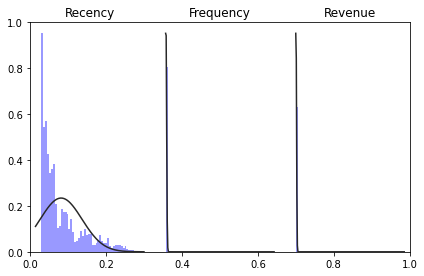

In [105]:
fig, ax = plt.subplots()

for i, col in enumerate(RFM.columns):
    ax=fig.add_subplot(1, 3, i+1)
    sns.distplot(RFM[col],fit=norm, kde=False,ax=ax, color='b')
    plt.title(col);
    plt.axis('off')
    plt.tight_layout()

In [106]:
rfm = RFM
rfm['r_quartile'] = pd.qcut(rfm['Recency'], 4, ['1','2','3','4'])
rfm['f_quartile'] = pd.qcut(rfm['Frequency'], 4, ['4','3','2','1'])
rfm['m_quartile'] = pd.qcut(rfm['Revenue'], 4, ['4','3','2','1'])
rfm.head()

,Recency,Frequency,Revenue,r_quartile,f_quartile,m_quartile
Donor ID,,,,,,
1f4b5b6e68445c6c4a0509b3aca93f38,126,314,139170.7300,2,1,1
bd323208dc78b1c74b62664b768f3176,1012,5,544.0000,4,4,2
6dd6113f89f2766d3b0707ef2a46260c,1025,27,519.3500,4,1,2
344ad0a72366a27bd4926bbe5d066939,242,9,344.8265,2,2,2
3cf2607d4131cd654bf54a1f5a533357,133,8,198.7500,2,3,3


In [107]:
rfm.r_quartile.unique()

[2, 4, 1, 3]
Categories (4, object): [1 < 2 < 3 < 4]

In [108]:
rfm.f_quartile.unique()

[1, 4, 2, 3]
Categories (4, object): [4 < 3 < 2 < 1]

In [109]:
rfm.m_quartile.unique()

[1, 2, 3, 4]
Categories (4, object): [4 < 3 < 2 < 1]

In [110]:
# Calculate RFM Score
# rfm['RFM_Score'] = rfm.r_quartile.astype(str)+ rfm.f_quartile.astype(str) + rfm.m_quartile.astype(str)
rfm['RFM_Score'] = rfm.r_quartile.astype(int)+ rfm.f_quartile.astype(int) + rfm.m_quartile.astype(int)
rfm.head(5)

,Recency,Frequency,Revenue,r_quartile,f_quartile,m_quartile,RFM_Score
Donor ID,,,,,,,
1f4b5b6e68445c6c4a0509b3aca93f38,126,314,139170.7300,2,1,1,4
bd323208dc78b1c74b62664b768f3176,1012,5,544.0000,4,4,2,10
6dd6113f89f2766d3b0707ef2a46260c,1025,27,519.3500,4,1,2,7
344ad0a72366a27bd4926bbe5d066939,242,9,344.8265,2,2,2,6
3cf2607d4131cd654bf54a1f5a533357,133,8,198.7500,2,3,3,8


In [111]:
# Filter out Top/Best donors
# RFM_Score = '111' means our best donors' score
# rfm[rfm['RFM_Score']=='111'].sort_values('Revenue', ascending=False).head()
rfm[rfm['RFM_Score']==12].sort_values('Revenue', ascending=False).head()

,Recency,Frequency,Revenue,r_quartile,f_quartile,m_quartile,RFM_Score
Donor ID,,,,,,,
1394f27e6548abd3da1a3622a85159e5,608,6,177.5,4,4,4,12
27737372f14c961f7ca6197bbb13a513,635,6,177.5,4,4,4,12
7addbd30638a44eb0eea8727174b0544,755,6,177.5,4,4,4,12
20398e26c07b8f4cf37b36d40050b285,636,5,177.5,4,4,4,12
6d6777b4d7e6b84fa36db74cf3deb033,858,5,177.5,4,4,4,12


**1.5. Build a 3D graph where axes represent the R, F and, M values and the hue (color of shade) represents the score. Based on the graph on how many categories would you cluster the donors? Please explain your decision. (0.50 points)**

In [112]:
import plotly.express as px
dff = rfm
fig = px.scatter_3d(dff, x='Revenue', y='Frequency', z='Recency',
              color='RFM_Score', size_max=20,opacity=0.7)
fig.show()

**<font color='red'>Answer:</font>** 

<!-- Based on 3d graph above, I'll cluster the donors into **three categories**. The reason is because of the the group of same colors on bottom side (blue), middle side (green), and top side (purple). -->

Based on 3d graph above, I'll cluster the donors into **four categories**. The reason is because of the the group of same colors on bottom side (dark blue), middle side (purple and orange), and top side (yellow).

**1.6. Interpret what the minimum, maximum and mean score indicates about your donors ?(0.50 points)**

In [113]:
rfm['RFM_Score'] = rfm['RFM_Score'].astype(int)
rfm['RFM_Score'].describe()

count    129065.000000
mean          7.724821
std           2.559632
min           3.000000
25%           6.000000
50%           8.000000
75%          10.000000
max          12.000000
Name: RFM_Score, dtype: float64

**<font color='red'>Answer:</font>** 

<!-- - minimum = 111, it means that these are our top or best donors who have the lowest recency, highest frequency and revenues.
- maximum = 444, it means that these are our lowest performance or worst donors who have the highest recency, lowest frequency and revenues.
- mean = 279.59, it means that the average RFM_Score of our donors are around `244 to 311` -->

- minimum = 3, it means that these are our lowest performance or worst donors who have the highest recency, lowest frequency and revenues
- maximum = 12, it means that these are our top or best donors who have the lowest recency, highest frequency and revenues
- mean = 7.72, it means that the average RFM_Score of our donors are around `7-8`

**1.7. Based on your answer in the question 1.5, please threshold the scores to create as many clusters as you think is reasonable. Assign integer values to those clusters to ease the identification and add a new column to your RFM data frame which shows the cluster each record belongs to. (0.30 points)**

In [114]:
rfm.loc[rfm['RFM_Score'] <= 12, 'ClusterType'] = 1 # the first-medium value
rfm.loc[rfm['RFM_Score'] <= 8, 'ClusterType'] = 2 # the second-medium value
rfm.loc[rfm['RFM_Score'] < 7, 'ClusterType'] = 3 # the highest value
rfm.loc[rfm['RFM_Score'] == 3, 'ClusterType'] = 4 # the lowest value

rfm.head()

,Recency,Frequency,Revenue,r_quartile,f_quartile,m_quartile,RFM_Score,ClusterType
Donor ID,,,,,,,,
1f4b5b6e68445c6c4a0509b3aca93f38,126,314,139170.7300,2,1,1,4,3.0
bd323208dc78b1c74b62664b768f3176,1012,5,544.0000,4,4,2,10,1.0
6dd6113f89f2766d3b0707ef2a46260c,1025,27,519.3500,4,1,2,7,2.0
344ad0a72366a27bd4926bbe5d066939,242,9,344.8265,2,2,2,6,3.0
3cf2607d4131cd654bf54a1f5a533357,133,8,198.7500,2,3,3,8,2.0


# 2. Automated clustering algorithms (4.1 points)

**2.1. Use K-Means algorithm with parameter "max_iter = 1", to get the same number of clusters for RFM as you selected in the exercise 1.5.  Feed the RFM values at the same time to the algorithm (not separately). Store your result in a new column and name this column as Kmeans_cluster.(0.50 points)**

### Rescaling the Attributes

It is extremely important to rescale the variables so that they have a comparable scale.| There are two common ways of rescaling:

    Min-Max scaling
    Standardisation (mean-0, sigma-1)

Here, we will use Standardisation Scaling.

Reference: [Kaggle](https://www.kaggle.com/hellbuoy/online-retail-k-means-hierarchical-clustering#Step-4-:-Building-the-Model)

In [115]:
rfm_df = rfm[['Recency', 'Frequency', 'Revenue']]
rfm_df.head()

,Recency,Frequency,Revenue
Donor ID,,,
1f4b5b6e68445c6c4a0509b3aca93f38,126,314,139170.7300
bd323208dc78b1c74b62664b768f3176,1012,5,544.0000
6dd6113f89f2766d3b0707ef2a46260c,1025,27,519.3500
344ad0a72366a27bd4926bbe5d066939,242,9,344.8265
3cf2607d4131cd654bf54a1f5a533357,133,8,198.7500


In [116]:
# Instantiate
scaler = StandardScaler()

# fit_transform
rfm_df_scaled = scaler.fit_transform(rfm_df)
rfm_df_scaled.shape

(129065, 3)

In [117]:
rfm_df_scaled = pd.DataFrame(rfm_df_scaled)
rfm_df_scaled.columns = ['Amount', 'Frequency', 'Recency']
rfm_df_scaled.head()

,Amount,Frequency,Recency
0,-0.693076,2.633495,16.345575
1,1.406289,-0.104656,-0.047962
2,1.437092,0.090293,-0.050877
3,-0.418216,-0.069211,-0.071516
4,-0.676490,-0.078072,-0.088790


In [118]:
kmeans = KMeans(n_clusters=12, max_iter=1).fit(rfm_df_scaled)
rfm["Kmeans_cluster"] = kmeans.labels_+1
rfm.head()

,Recency,Frequency,Revenue,r_quartile,f_quartile,m_quartile,RFM_Score,ClusterType,Kmeans_cluster
Donor ID,,,,,,,,,
1f4b5b6e68445c6c4a0509b3aca93f38,126,314,139170.7300,2,1,1,4,3.0,8
bd323208dc78b1c74b62664b768f3176,1012,5,544.0000,4,4,2,10,1.0,2
6dd6113f89f2766d3b0707ef2a46260c,1025,27,519.3500,4,1,2,7,2.0,2
344ad0a72366a27bd4926bbe5d066939,242,9,344.8265,2,2,2,6,3.0,1
3cf2607d4131cd654bf54a1f5a533357,133,8,198.7500,2,3,3,8,2.0,1


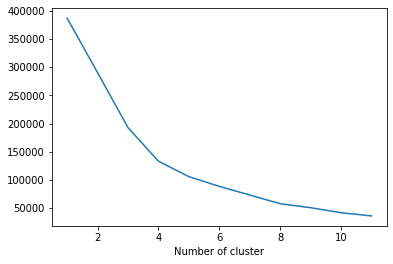

In [119]:
from sklearn.cluster import KMeans

sse={}

for k in range(1, 12):
    kmeans = KMeans(n_clusters=k, max_iter=1).fit(rfm_df_scaled)
#     tx_recency["clusters"] = kmeans.labels_
    sse[k] = kmeans.inertia_ 
    
#print(sse)
    
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()

**2.2. Take a look at the cluster centers given by KMeans after prediction. Are they identical to mean value of each cluster ? If yes, why do you think so? If no, why do you think so? In case the answer is no, please try to change the parameters of the function so the cluster center and the mean value of clusters will be identical. Store and report the new results. (0.75 points)**

In [120]:
rfm.groupby('Kmeans_cluster')['RFM_Score'].describe()

,count,mean,std,min,25%,50%,75%,max
Kmeans_cluster,,,,,,,,
1,75976.0,6.650482,2.279634,3.0,5.0,7.0,9.0,11.0
2,15436.0,9.756349,1.854343,6.0,8.0,10.0,11.0,12.0
3,6.0,3.000000,0.000000,3.0,3.0,3.0,3.0,3.0
4,7.0,3.428571,1.133893,3.0,3.0,3.0,3.0,6.0
5,52.0,3.288462,0.749811,3.0,3.0,3.0,3.0,6.0
6,1.0,3.000000,NaN,3.0,3.0,3.0,3.0,3.0
7,9992.0,10.128803,1.777348,6.0,9.0,10.0,12.0,12.0
8,28.0,3.535714,0.838082,3.0,3.0,3.0,4.0,6.0
9,26507.0,8.897650,1.934502,5.0,7.0,9.0,11.0,12.0


In [121]:
km = KMeans(n_clusters=4, max_iter=1)
km.fit(rfm_df)
rfm["Kmeans_cluster"] = kmeans.labels_+1
rfm.head()

,Recency,Frequency,Revenue,r_quartile,f_quartile,m_quartile,RFM_Score,ClusterType,Kmeans_cluster
Donor ID,,,,,,,,,
1f4b5b6e68445c6c4a0509b3aca93f38,126,314,139170.7300,2,1,1,4,3.0,9
bd323208dc78b1c74b62664b768f3176,1012,5,544.0000,4,4,2,10,1.0,3
6dd6113f89f2766d3b0707ef2a46260c,1025,27,519.3500,4,1,2,7,2.0,3
344ad0a72366a27bd4926bbe5d066939,242,9,344.8265,2,2,2,6,3.0,6
3cf2607d4131cd654bf54a1f5a533357,133,8,198.7500,2,3,3,8,2.0,6


In [122]:
# centroids = km.cluster_centers_
# centroids

**<font color='red'>Answer:</font>** 

**2.3. Compare the results you produced in exercise 1.7 with the results generated by KMeans i.e number of elements in each class, mean and std values for elements in each class. Which approach do you think is better or are they similar ? Hint: Plot histogram and/or boxplot (0.75 points)**

In [123]:
# plt.hist(rfm.ClusterType, bins = 4)
# plt.show()

# plot_data = [
#     go.Histogram(
#         x=rfm.ClusterType
#     )
# ]

# plot_layout = go.Layout(
#         title='Distribution of ClusterType'
#     )

# fig = go.Figure(data=plot_data, layout=plot_layout)
# pyoff.iplot(fig)


fig = make_subplots(rows=1, cols=2)

fig.add_trace(
    go.Histogram(x=rfm.ClusterType, name="Exercise 1.7"),
    row=1, col=1
)

fig.add_trace(
    go.Histogram(x=rfm.Kmeans_cluster, name="Kmeans"),
    row=1, col=2
)

fig.update_layout(height=600, width=800, title_text="Comparison of the Cluster Results")
# fig.show()
pyoff.iplot(fig)

In [124]:
rfm.ClusterType.describe()

count    129065.000000
mean          1.966513
std           0.976952
min           1.000000
25%           1.000000
50%           2.000000
75%           3.000000
max           4.000000
Name: ClusterType, dtype: float64

In [125]:
rfm.Kmeans_cluster.describe()

count    129065.000000
mean          4.724108
std           2.613511
min           1.000000
25%           3.000000
50%           6.000000
75%           6.000000
max          11.000000
Name: Kmeans_cluster, dtype: float64

**<font color='red'>Answer:</font>**

- From the result of the exercise 1.7, it showed relatively balanced value for each class, with cluster type 1 is the highest one with almost 50% of total number of elements 
- From the result of the Kmeans algorithm, it showed cluster number 1 give more than 70% of total number of elements

**2.4. To overcome the limitations of KMeans many other clustering algorithms are used, one of them is DBSCAN. Mention at least 2 advantages of DBSCAN over KMeans and 2 disadvantages of DBSCAN.(0.30 points)**

**<font color='red'>Answer:</font>**

**Advantages:**

- DBSCAN can resolves some problems from KMeans (which doesn't care about how dense the data present), by working with the density of points
- Great when handling with outliers in the dataset

**Disadvantages:**

- It doesn't work well with the cluster which has varying densities
- Struggles with high dimensionality data

**2.5. Use DBSCAN  with its default parameters to generate clusters based on RFM values. How many clusters did it create? Was the value same as you selected in the exercise 1.5?(0.50 points)**

In [126]:
# dbscan = DBSCAN(eps=0.3, min_samples=2).fit(rfm_df_scaled)
dbscan = DBSCAN()

In [127]:
rfm_df_scaled.count()

Amount       129065
Frequency    129065
Recency      129065
dtype: int64

In [128]:
# Because DBSCAN had struggles with high dimensionality data, we subset the 120k+ rows of data into 10k rows
rfm_df_scaled_10000 = rfm_df_scaled.head(10000)
rfm_df_scaled_10000.count()

Amount       10000
Frequency    10000
Recency      10000
dtype: int64

In [129]:
rfm_10000 = rfm.head(10000)
rfm_10000.count()

Recency           10000
Frequency         10000
Revenue           10000
r_quartile        10000
f_quartile        10000
m_quartile        10000
RFM_Score         10000
ClusterType       10000
Kmeans_cluster    10000
dtype: int64

In [130]:
# dbscan.fit(rfm_df_scaled)
dbscan.fit(rfm_df_scaled_10000)

DBSCAN(algorithm='auto', eps=0.5, leaf_size=30, metric='euclidean',
       metric_params=None, min_samples=5, n_jobs=None, p=None)

In [131]:
rfm_10000['DBSCAN_Cluster'] = dbscan.labels_ + 2
rfm_10000.head()

,Recency,Frequency,Revenue,r_quartile,f_quartile,m_quartile,RFM_Score,ClusterType,Kmeans_cluster,DBSCAN_Cluster
Donor ID,,,,,,,,,,
1f4b5b6e68445c6c4a0509b3aca93f38,126,314,139170.7300,2,1,1,4,3.0,9,1
bd323208dc78b1c74b62664b768f3176,1012,5,544.0000,4,4,2,10,1.0,3,2
6dd6113f89f2766d3b0707ef2a46260c,1025,27,519.3500,4,1,2,7,2.0,3,2
344ad0a72366a27bd4926bbe5d066939,242,9,344.8265,2,2,2,6,3.0,6,2
3cf2607d4131cd654bf54a1f5a533357,133,8,198.7500,2,3,3,8,2.0,6,2


In [132]:
rfm_10000['DBSCAN_Cluster'].unique()

array([1, 2, 3, 4, 5, 7, 6, 8])

**2.6. In 2.5, how many noisy data points were identified by the DBSCAN? (0.30 points)**

**<font color='red'>Answer:</font>**

**2.7 Try different combinations of "eps" and "min_samples" parameters for DBSCAN in order to reach the same number of classes as in exercise 1.5 (at most you can have a difference of 10 classes). Report the combination that gave the best result (0.75 points). Why do you think it worked and the number of classes decreased compared to exercise 2.5? (0.25 points)** 

**<font color='red'>Answer:</font>**

# 3. Regression (2.9 points)



For this exercise we are going to use the Prices dataset which contains 74 columns. Each column explains a  characteristic of houses in sale. The last column is describing their prices. 

In [133]:
data = pd.read_csv("Prices.csv")
data.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,...,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,...,0,0,0,0,0,2,2008,WD,Normal,208500
1,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,...,0,0,0,0,0,5,2007,WD,Normal,181500
2,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,...,0,0,0,0,0,9,2008,WD,Normal,223500
3,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,...,272,0,0,0,0,2,2006,WD,Abnorml,140000
4,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,...,0,0,0,0,0,12,2008,WD,Normal,250000


Before using the data we have to apply some preprocessing:
- Apply one-hot encoding to categorical data types
- Apply logarithmic transformation to the data
- Replace negative infinite values with 0

In [134]:
X = data.iloc[:, 0:-1]
y = data.iloc[:, -1]

data = pd.get_dummies(X)
data["SalePrice"]=y

data = np.log(data)

data[data==-np.inf]=0

Now the data is ready for you to use in the next exercises.

**3.1. Calculate the correlation between price and each feature. Which are the top 3 features that have the highest correlation with  price? Is the correlation positive or negative? Explain what happens with the price when each of 
those 3 features change (consider only one feature at a time) and others are kept constant. (0.50 points)** 



In [135]:
data.head()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,...,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_Abnorml,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial,SalePrice
0,4.094345,4.174387,9.041922,1.945910,1.609438,7.602401,7.602401,5.278115,6.559615,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.247694
1,2.995732,4.382027,9.169518,1.791759,2.079442,7.588830,7.588830,0.000000,6.885510,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.109011
2,4.094345,4.219508,9.328123,1.945910,1.609438,7.601402,7.601902,5.087596,6.186209,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.317167
3,4.248495,4.094345,9.164296,1.945910,1.609438,7.557473,7.585789,0.000000,5.375278,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,11.849398
4,4.094345,4.430817,9.565214,2.079442,1.609438,7.600902,7.600902,5.857933,6.484635,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.429216


In [136]:
correlation = data.corr()
# print(correlation['SalePrice'].sort_values(ascending = False), '\n')
correlation[correlation['SalePrice'] >= 0]['SalePrice'].sort_values(ascending = False)

# Reference
# https://www.kaggle.com/vpfahad/housing-price-regression-for-absolute-beginners

SalePrice       1.000000
OverallQual     0.794007
GrLivArea       0.730255
GarageCars      0.659806
1stFlrSF        0.608947
FullBath        0.598520
YearBuilt       0.584442
YearRemodAdd    0.565590
GarageYrBlt     0.539621
TotRmsAbvGrd    0.539261
OpenPorchSF     0.460081
GarageArea      0.455197
MasVnrArea      0.418752
LotArea         0.399918
TotalBsmtSF     0.373009
LotFrontage     0.364108
WoodDeckSF      0.343269
Fireplaces      0.210056
BedroomAbvGr    0.209210
BsmtUnfSF       0.208103
BsmtFinSF1      0.207962
2ndFlrSF        0.180828
ScreenPorch     0.105909
PoolArea        0.069949
3SsnPorch       0.058838
MoSold          0.051392
BsmtFullBath    0.042886
OverallCond     0.008710
Name: SalePrice, dtype: float64

<font color='red'> **Answer:**</font> 

- Top 3 features with highest correlation with `SalePrice`:
    - OverallQual
    - GrLivArea
    - GarageCars
- Correlation is positive
- When each of these 3 features got a change of value, the `SalePrice` variable will change significantly

**3.2.  In this exercise we have to build  a regression model using training data and then predict the price in test data. You are free to select features which you want to use for building the model. As the data has missing values we are asking you to try the following methods for dealing with the missing data:**

a) mean imputation

b) median imputation

c) mode imputation

d) dropping missing values


**For each of these cases report MAE, RMSE and R<sup>2</sup>. Which method works better ?**

**To get the training and test set, split  the data into 20% test set and 80% training set using train_test_split function from scikit-learn. Keep the parameter random_state equal to 0. (1.50 points)**

In [137]:
# Import Library
from sklearn.model_selection import train_test_split # for data splitting
from sklearn.metrics import mean_squared_error # for model evaluation
from sklearn.metrics import r2_score # model evaluation
from sklearn.metrics import median_absolute_error # model evaluation
from sklearn.linear_model import LinearRegression

In [138]:
# Mean and Mode Imputation for Missing Values
data.fillna(data.mean(), inplace=True)
data.fillna(data.mode(), inplace=True)

# Check missing value
data.isnull().sum().sum()

0

In [139]:
# Select features which have correlation with SalePrice more than 50 percents
correlation[correlation['SalePrice'] >= 0.5]['SalePrice'].sort_values(ascending = False)

SalePrice       1.000000
OverallQual     0.794007
GrLivArea       0.730255
GarageCars      0.659806
1stFlrSF        0.608947
FullBath        0.598520
YearBuilt       0.584442
YearRemodAdd    0.565590
GarageYrBlt     0.539621
TotRmsAbvGrd    0.539261
Name: SalePrice, dtype: float64

In [140]:
# Try to change one of the highest correlated features
highest_corr_features = data[['SalePrice', 'OverallQual', 'GrLivArea', 'GarageCars', 'GarageArea',
                             'FullBath', '1stFlrSF', 'YearRemodAdd', 'YearBuilt', 'GarageYrBlt', 'TotRmsAbvGrd']]
highest_corr_features.head()

,SalePrice,OverallQual,GrLivArea,GarageCars,GarageArea,FullBath,1stFlrSF,YearRemodAdd,YearBuilt,GarageYrBlt,TotRmsAbvGrd
0,12.247694,1.945910,7.444249,0.693147,6.306275,0.693147,6.752270,7.602401,7.602401,7.602401,2.079442
1,12.109011,1.791759,7.140453,0.693147,6.131226,0.693147,7.140453,7.588830,7.588830,7.588830,1.791759
2,12.317167,1.945910,7.487734,0.693147,6.410175,0.693147,6.824374,7.601902,7.601402,7.601402,1.791759
3,11.849398,1.945910,7.448334,1.098612,6.464588,0.000000,6.867974,7.585789,7.557473,7.599902,1.945910
4,12.429216,2.079442,7.695303,1.098612,6.728629,0.693147,7.043160,7.600902,7.600902,7.600902,2.197225


In [141]:
# drop our target variable
X = highest_corr_features.loc[:, highest_corr_features.columns != 'SalePrice'] 

# our target variable that we need to predict
y = highest_corr_features[['SalePrice']]

# split the data to train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=0)

# make an instance from the lr model
lin_reg_mod = LinearRegression()

# train the model - teach the model
lin_reg_mod.fit(X_train, y_train)

# predict unseen data (test dat)
pred = lin_reg_mod.predict(X_test)


In [142]:
# Evaluate the LR model
# MAE
test_set_mae = median_absolute_error(y_test, pred)
# RMSE
test_set_rmse = (np.sqrt(mean_squared_error(y_test, pred)))
#R^2
test_set_r2 = r2_score(y_test, pred)
#MSE
test_set_mse = (mean_squared_error(y_test, pred))

metric_values = [test_set_mse, test_set_rmse, test_set_mae,test_set_r2 ]
idx = ['MSE', 'RMSE', 'MAE', 'R2']
#pd.DataFrame(metric_values, index=idx)


# print("mean squared error is: ", test_set_mse)
# print("root mean squared error is: ", test_set_rmse)
# print("mean absolute error is: ", test_set_mae)
# print("rscore: ", test_set_r2)

pd.DataFrame(metric_values, columns=['Model_evaluation'],index=idx)

,Model_evaluation
MSE,0.032021
RMSE,0.178944
MAE,0.082128
R2,0.788500


In [143]:
# print('coef: ', lin_reg_mod.coef_)
# print('\nintercept: ', lin_reg_mod.intercept_)

<font color='red'> **Answer:**</font> R-squared

In [144]:
## Place here the values for MAE, RMSE, R^2 received from the best method
mae_best = 0.082128
rmse_best = 0.178944
r2_best = 0.788500

**3.3 From 3.2 keep the best method to deal with missing values and use PCA to reduce the number of features to 34 components. Keep random_state for PCA equal to 0. (0.30 points)**

In [145]:
x = data.loc[:, data.columns != 'SalePrice'] # features 
y = data[['SalePrice']] # target / label

In [146]:
x.shape

(1460, 270)

In [147]:
y.shape

(1460, 1)

In [148]:
from sklearn.decomposition import PCA
from sklearn.model_selection import KFold
from sklearn import linear_model
from sklearn.metrics import make_scorer
from sklearn.metrics import r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
import matplotlib.pyplot as plt
import seaborn
import warnings
warnings.filterwarnings('ignore');

In [149]:
# features and target
X = x
y = y

# convert features to numpy array
X = X.to_numpy()

# n_components: Number of components (features) to keep.

# whiten: When True (False by default) the components_ vectors are multiplied by the square root of n_samples
# and then divided by the singular values to ensure uncorrelated outputs with unit component-wise variances.

# svd (Singular Value Decomposition): project data to a lower dimensional space.

# get an instance from PCA
pca = PCA(n_components=34,whiten=True,svd_solver='randomized',random_state=0)

# fitting or teaching PCA 
pca = pca.fit(X)

# generate new features based on PCA technique by using transform()
dataPCA = pca.transform(X)

**3.4. What percentage of the variance is explained by the first component ? (0.30 points)**

<font color='red'> **Answer:**</font>


**3.5. Use the new components derived from PCA to predict the house pricing. Keep the ratio of test and train set to 20/80 and the random_state equal to 0. Report MAE, RMSE and R<sup>2</sup> (0.30 points)**

In [150]:
# manual method to split data (original data)
train_original = X[:1200]
test_original = X[1200:]

train_y_orig = y[:1200]
test_y_orig = y[1200:]


# Split traing and test
train_pca = dataPCA[:1200]
test_pca = dataPCA[1200:]

In [151]:
def get_mae(x_train, y_train, x_test,y_test):
    results={}
    
    def mae_model(clf):  
        # train the model - teach the model
        clf.fit(x_train, y_train)

        # predict unseen data (test dat)
        pred = clf.predict(x_test)

        # R2
        mae_val_score = median_absolute_error(y_test, pred)

        scores=[mae_val_score.mean()]
        return scores

    clf = linear_model.LinearRegression()
    results["MAE"]=mae_model(clf)

    
    results = pd.DataFrame.from_dict(results,orient='index')
    results.columns=["MAE Score"] 
#     results.plot(kind="bar",title="Model Scores")
#     axes = plt.gca()
#     axes.set_ylim([0.05,0.1])
    return results

# PCA model
get_mae(train_pca, train_y_orig, test_pca,test_y_orig)

,MAE Score
MAE,0.076847


In [152]:
def get_rmse(x_train, y_train, x_test,y_test):
    results={}
    
    def rmse_model(clf):  
        # train the model - teach the model
        clf.fit(x_train, y_train)

        # predict unseen data (test dat)
        pred = clf.predict(x_test)

        # RMSE
        rmse_val_score = np.sqrt(mean_squared_error(y_test, pred))

        scores=[rmse_val_score.mean()]
        return scores

    clf = linear_model.LinearRegression()
    results["RMSE"]=rmse_model(clf)

    
    results = pd.DataFrame.from_dict(results,orient='index')
    results.columns=["RMSE Score"] 
# #     results.plot(kind="bar",title="Model Scores")
# #     axes = plt.gca()
# #     axes.set_ylim([0.1,0.2])
    return results

# PCA model
get_rmse(train_pca, train_y_orig, test_pca,test_y_orig)

,RMSE Score
RMSE,0.178679


In [153]:
def get_r2(x_train, y_train, x_test,y_test):
    results={}
    
    def r2_model(clf):  
        # train the model - teach the model
        clf.fit(x_train, y_train)

        # predict unseen data (test dat)
        pred = clf.predict(x_test)

        # R2
        r2_val_score = r2_score(y_test, pred)

        scores=[r2_val_score.mean()]
        return scores

    clf = linear_model.LinearRegression()
    results["R-square"]=r2_model(clf)

    
    results = pd.DataFrame.from_dict(results,orient='index')
    results.columns=["R Square Score"]
#     results.plot(kind="bar",title="Model Scores")
#     axes = plt.gca()
#     axes.set_ylim([0.5,1])
    return results

# # orig model
# lets_try(train_original,train_y_orig, test_original,test_y_orig)

# PCA model
get_r2(train_pca, train_y_orig, test_pca,test_y_orig)

,R Square Score
R-square,0.778821


In [154]:
## Calculate the values for MAE, RMSE, R^2 received after applying PCA

mae_pca = 0.076847
rmse_pca = 0.178679
r2_pca = 0.778821


In [155]:
print("MAE difference after PCA: ", mae_best-mae_pca)
print("RMSE difference after PCA: ", rmse_best-rmse_pca)
print("R2 difference after PCA: ", r2_best-r2_pca)

MAE difference after PCA:  0.005281000000000008
RMSE difference after PCA:  0.00026499999999998747
R2 difference after PCA:  0.009678999999999993


## How long did it take you to solve the homework?

* Please answer as precisely as you can. It does not affect your points or grade in any way. It is okay, if it took 0.5 hours or 24 hours. The collected information will be used to improve future homeworks.

<font color='red'> **Answer:**</font>

**<font color='red'>(please change X in the next cell into your estimate)</font>**

10 hours

## What is the level of difficulty for this homework?
you can put only number between $0:10$ ($0:$ easy, $10:$ difficult)

<font color='red'> **Answer:**</font>

In [156]:
8

8